## Exploring spectrograms
This is an introduction to spectrograms: what they look like through Librosa, how they correspond to their waveform and recording. The ipd.Audio code creates a widget in Jupyter Notebook that will playback the audio. This won't show up in github notebooks, but I'm leaving in here in case you want to code along with the example files provided under Data. If ipd.Audio widget does not work, you should be able to play the .wav files through any generic media player.  

These are not scaled in the same way as those spectrograms prepared for CNN. These are left in a format more easily perceived by, you know, eyes. Details about preprocessing protocol for actual model training data are in following notebooks.

In [1]:
import matplotlib.pyplot as plt
import os
import IPython.display as ipd

import librosa
import librosa.display

In [2]:
in_path = '../data/acoustic_samples/'
samps = os.listdir(in_path)
samps

['dolphin_barely.e.wav',
 'mechanical.e.wav',
 'humpbacks.e.wav',
 'haunted_nodolphin.e.wav',
 'pinger_faint.e.wav',
 'dolphin_lots.e.wav',
 'pinger_close.e.wav',
 'ambient.e.wav']

### Example of a recording with 0 dolphin activity
Regular reef ambience, mostly snapping shrimp

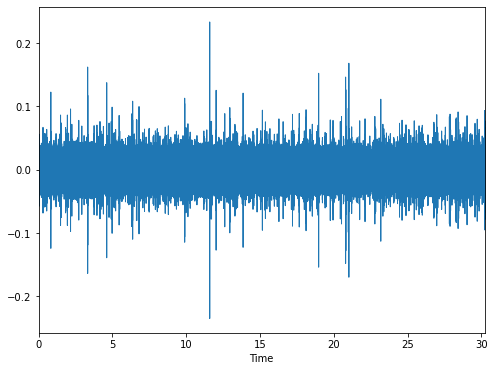

In [3]:
#waveform
ambient, sr = librosa.load(in_path + 'ambient.e.wav', sr=50000)
plt.figure(figsize=(8,6))
librosa.display.waveplot(ambient, sr = sr);

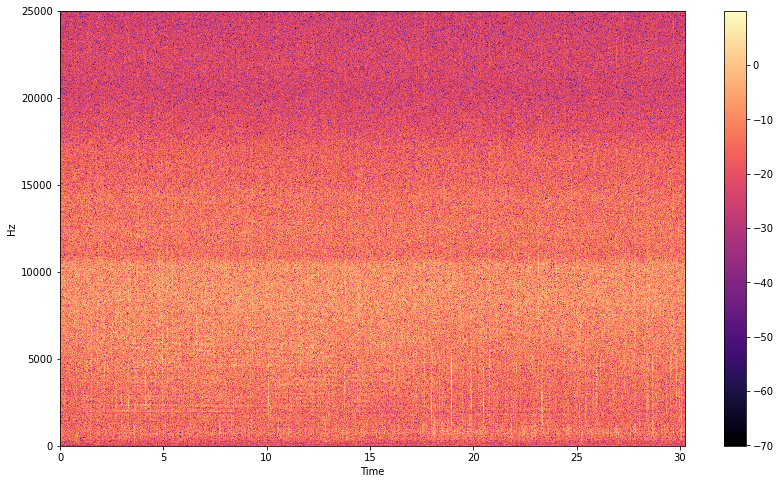

In [4]:
#spectrogram: ambient
ambient_stft = librosa.stft(ambient) #stft to map freq over time
Xdb = librosa.amplitude_to_db(abs(ambient_stft)) #change to dB for recognizable intensity unit
plt.figure(figsize=(14,8))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.colorbar();
#pylab.savefig('../scratch_data/images/empty.png')

In [5]:
#listen
ipd.Audio(in_path+'ambient.e.wav')

While all kinds of colorful in this specshow rendering, the input data that the CNN receives is this single-channel array:

In [6]:
# input array for generating spectrogram
Xdb

array([[-13.438711, -18.815784, -26.242584, ..., -17.948122, -12.140227,
        -10.645969],
       [-14.60157 , -19.964611, -20.672977, ..., -23.216286, -13.569799,
        -19.212484],
       [-11.978559, -17.332718, -16.359436, ..., -14.357149, -17.104626,
        -27.819536],
       ...,
       [-26.93731 , -28.046627, -24.56673 , ..., -26.09719 , -28.632984,
        -30.03134 ],
       [-70.07548 , -26.755878, -25.803288, ..., -23.639034, -23.306953,
        -24.615145],
       [-28.59103 , -30.82055 , -35.289806, ..., -27.015036, -27.173414,
        -19.881634]], dtype=float32)

### Second example of a recording with 0 dolphin activity
Considerable whale calls, anthropogenic noise (some kind of motor?), possibly souls of the undead.  
Note this is drastically different than example 1, but still a 'negative' file in our classification schema.

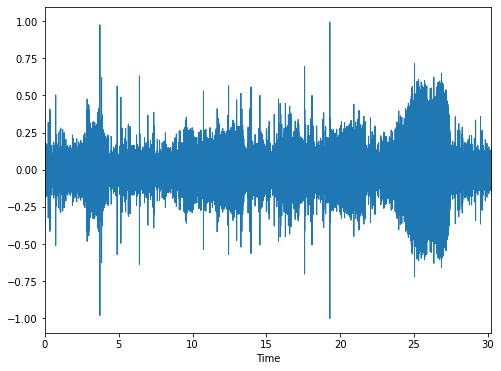

In [7]:
#waveform
busy_neg, sr = librosa.load(in_path + 'haunted_nodolphin.e.wav', sr=50000)
plt.figure(figsize=(8,6))
librosa.display.waveplot(busy_neg, sr = sr);

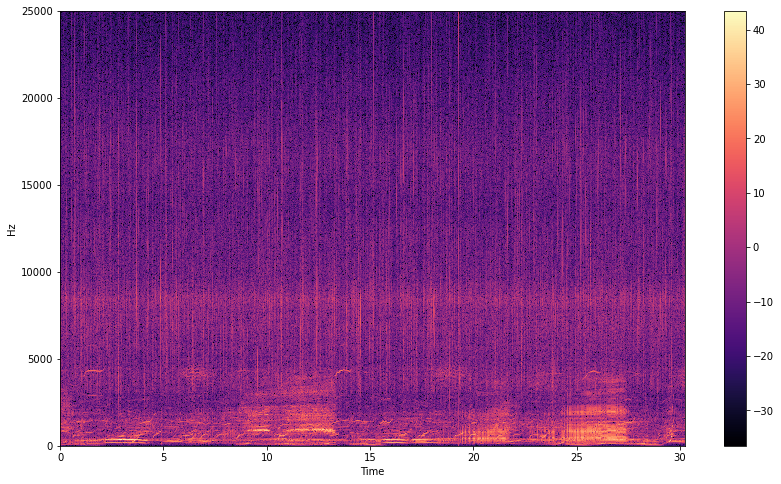

In [8]:
#spectrogram: lock the doors
busy_stft = librosa.stft(busy_neg)
Xdb = librosa.amplitude_to_db(abs(busy_stft))
plt.figure(figsize=(14,8))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.colorbar();

In [9]:
#listen
ipd.Audio(in_path+'haunted_nodolphin.e.wav')

### Significant dolphin activity
Note the similarity of the waveform to the example above (albiet at a different scale). The dolphin whistles themselves are visible middle of the spectrogram. They appear like zigzags and upsweeps of a lighter color than surrounding space ( = higher intensity).  
There are clicks present in this file, too. Clicks are acute, broadband signals, so would look like vertical lines in this representation but are mostly indistinguishable from other broadband noise in this frame. A good view of clicks requires an exceptionally quiet frame, or zooming in on the target region (and/or slowing down the audio playback), which I can't quite finagle in librosa.

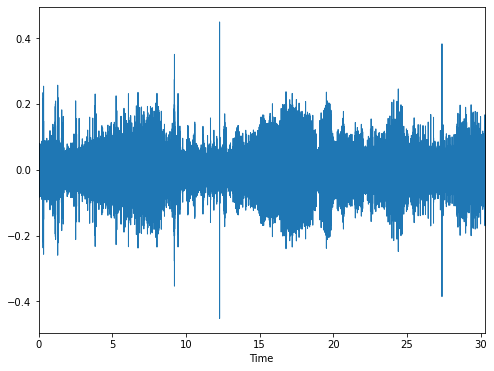

In [10]:
#waveform
busy_pos, sr = librosa.load(in_path + 'dolphin_lots.e.wav', sr=64000)
plt.figure(figsize=(8,6))
librosa.display.waveplot(busy_pos, sr = sr);

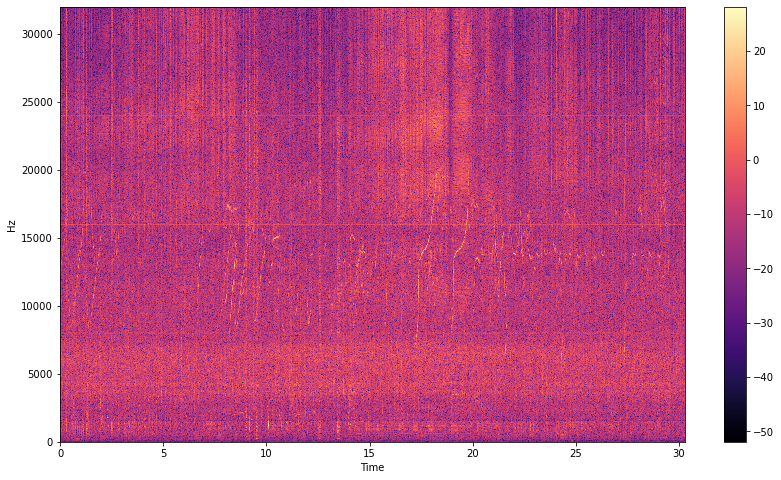

In [11]:
#spectrogram: dolphin party
busy_p_stft = librosa.stft(busy_pos)
Xdb = librosa.amplitude_to_db(abs(busy_p_stft))
plt.figure(figsize=(14,8))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.colorbar();
#pylab.savefig('../images/busy_spec.png')

In [12]:
ipd.Audio(in_path+'dolphin_lots.e.wav')

### Insignificant dolphin activity
Note the similarity in waveform and spectrogram to the first example of empty abience. The spectrogram below includes a single whistle in the first 5 seconds of the image. This should be classified as a positive file, despite it's similarity to example 1.

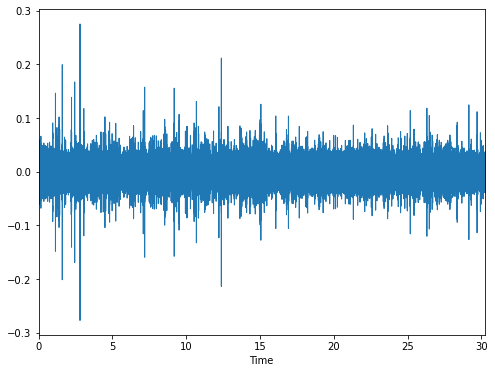

In [13]:
#waveform
sparse, sr = librosa.load(in_path + 'dolphin_barely.e.wav', sr=50000)
plt.figure(figsize=(8,6))
librosa.display.waveplot(sparse, sr = sr);

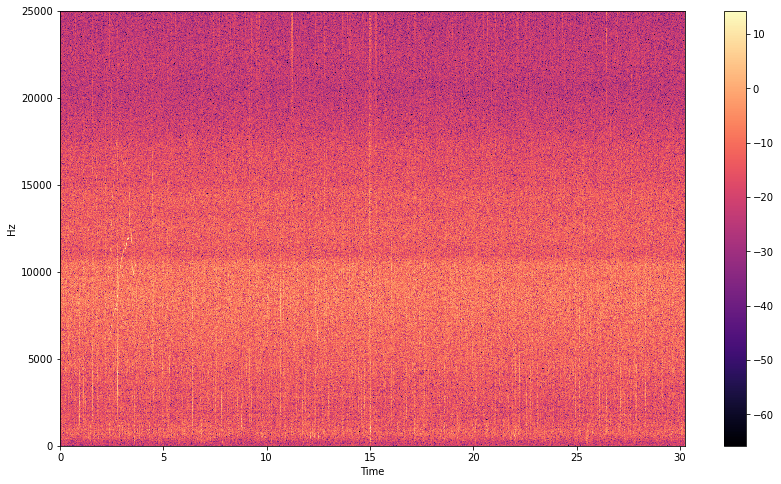

In [14]:
#spectrogram: dolphin loner
sparse_stft = librosa.stft(sparse)
Xdb = librosa.amplitude_to_db(abs(sparse_stft))
plt.figure(figsize=(14,8))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.colorbar();

In [15]:
ipd.Audio(in_path+'dolphin_barely.e.wav')

### Other random examples from this dataset
Ditching waveforms - you get the picture. Just providing spectrograms and audio playback. Messing with color scheme just for fun. Different color schemes may be more color-blind friendly.

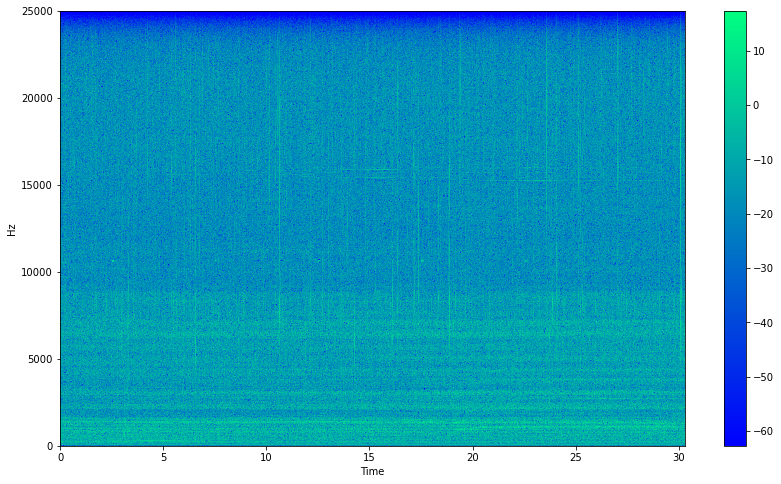

In [16]:
# 'mechanical': low frequency engine noise, faint ping
mech, sr = librosa.load(in_path + 'mechanical.e.wav', sr=50000)
mech_stft = librosa.stft(mech)
Xdb = librosa.amplitude_to_db(abs(mech_stft))
plt.figure(figsize=(14,8))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz', cmap='winter')
plt.colorbar();
#pylab.savefig('../images/busy_spec.png')

In [17]:
ipd.Audio(in_path+'mechanical.e.wav')

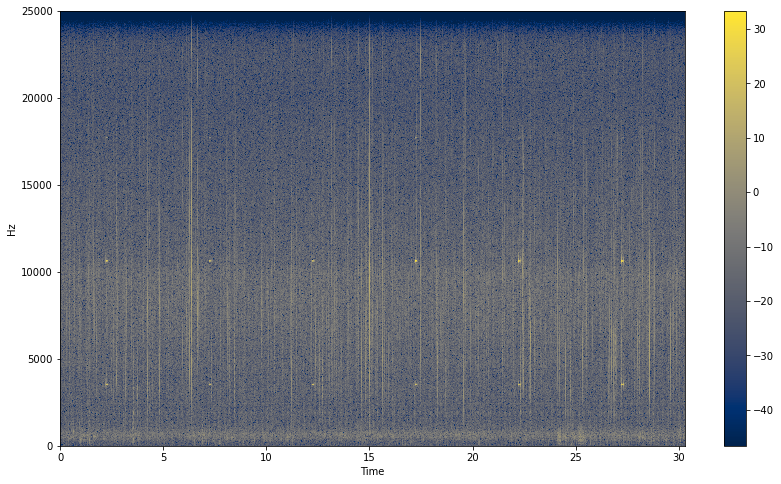

In [18]:
#pinger
ping, sr = librosa.load(in_path + 'pinger_close.e.wav', sr=50000)
ping_stft = librosa.stft(ping)
Xdb = librosa.amplitude_to_db(abs(ping_stft))
plt.figure(figsize=(14,8))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz', cmap='cividis')
plt.colorbar();

In [19]:
ipd.Audio(in_path+'pinger_close.e.wav')

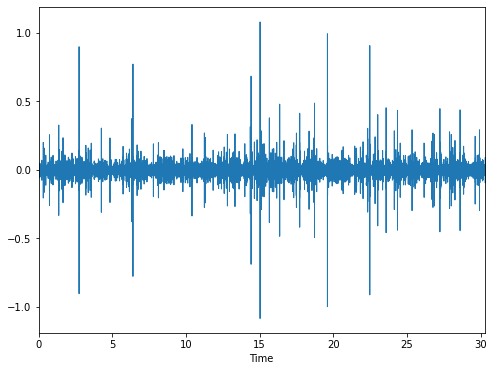

In [20]:
#pinger waveform bc curious
plt.figure(figsize=(8,6))
librosa.display.waveplot(ping, sr = sr);

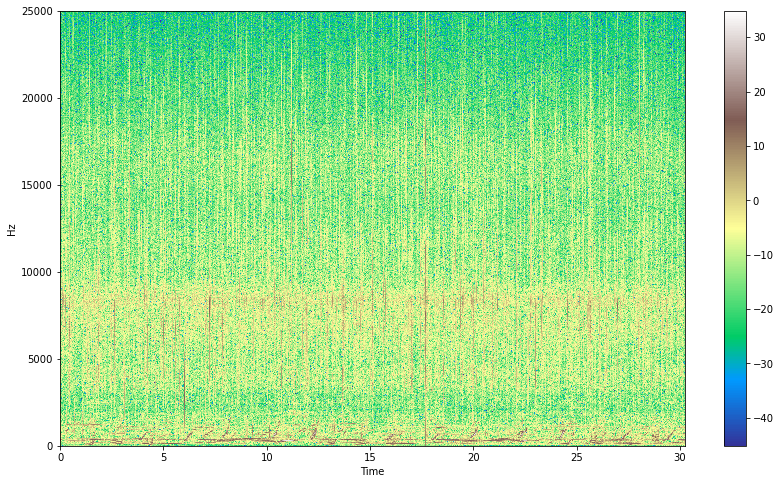

In [21]:
#humpbacks
whales, sr = librosa.load(in_path + 'humpbacks.e.wav', sr=50000)
whales_stft = librosa.stft(whales)
Xdb = librosa.amplitude_to_db(abs(whales_stft))
plt.figure(figsize=(14,8))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz', cmap='terrain')
plt.colorbar();
#pylab.savefig('../images/busy_spec.png')